# Librairy

In [22]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

# Load data

In [23]:
df_train = pd.read_csv("../Data/train.csv")
df_test = pd.read_csv("../Data/test.csv")
df_test_label = pd.read_csv("../Data/test_labels.csv")
df_sample_submission = pd.read_csv("../Data/sample_submission.csv")

In [24]:
df_train.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0


# Statistics

In [26]:
df_melted = df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].melt(
    var_name='toxic_type', value_name='count')

In [27]:
fig = px.histogram(df_melted, x='toxic_type', y='count', 
                   title="Distribution des types de toxicité", 
                   labels={'toxic_type': 'Type de toxicité', 'count': 'Nombre'},
                   histfunc='sum', 
                   color='toxic_type')

fig.show()

In [38]:
compte_toxicite = df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].sum()
non_toxique = (df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].sum(axis=1) == 0).sum()
compte_toxicite['non_toxique'] = non_toxique


fig = px.pie(names=compte_toxicite.index, values=compte_toxicite.values,
             title="Répartition des commentaires selon les types de toxicité pour le train",
             labels={'non_toxique': 'Non Toxique', 'toxic': 'Toxique', 'severe_toxic': 'Très Toxique',
                     'obscene': 'Obscène', 'threat': 'Menace', 'insult': 'Insulte', 'identity_hate': 'Haine Identitaire'})

fig.show()

In [42]:
df_test_label

,id,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,00001cee341fdb12,-1,-1,-1,-1,-1,-1
1,0000247867823ef7,-1,-1,-1,-1,-1,-1
2,00013b17ad220c46,-1,-1,-1,-1,-1,-1
3,00017563c3f7919a,-1,-1,-1,-1,-1,-1
4,00017695ad8997eb,-1,-1,-1,-1,-1,-1
...,...,...,...,...,...,...,...
153159,fffcd0960ee309b5,-1,-1,-1,-1,-1,-1
153160,fffd7a9a6eb32c16,-1,-1,-1,-1,-1,-1
153161,fffda9e8d6fafa9e,-1,-1,-1,-1,-1,-1
153162,fffe8f1340a79fc2,-1,-1,-1,-1,-1,-1


In [29]:
moyenne_toxicite = df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].mean()
mediane_toxicite = df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].median()

print("Moyenne des scores de toxicité :")
print(moyenne_toxicite)
print("\nMédiane des scores de toxicité :")
print(mediane_toxicite)

Moyenne des scores de toxicité :
toxic            0.095844
severe_toxic     0.009996
obscene          0.052948
threat           0.002996
insult           0.049364
identity_hate    0.008805
dtype: float64

Médiane des scores de toxicité :
toxic            0.0
severe_toxic     0.0
obscene          0.0
threat           0.0
insult           0.0
identity_hate    0.0
dtype: float64


In [ ]:
fig = px.histogram(df_train, x='toxic', title='Distribution des scores de toxicité', labels={'toxic': 'Toxicité'})
fig.show()

In [31]:
correlation_toxicite = df_train[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].corr()

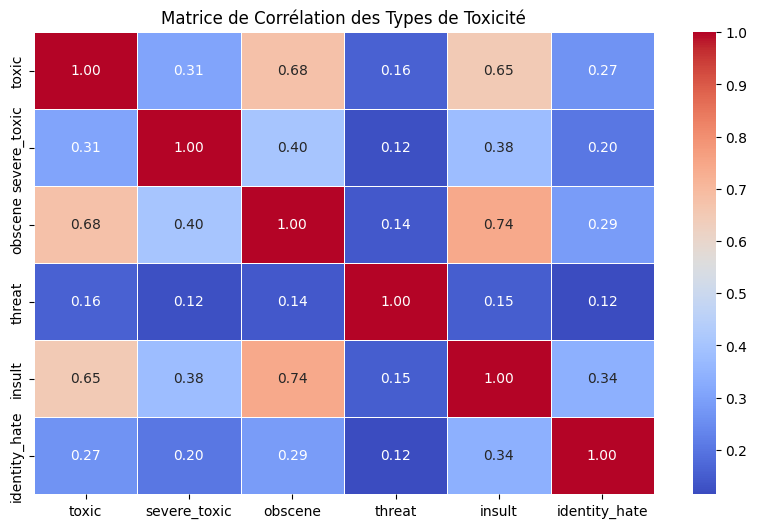

In [32]:
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_toxicite, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Matrice de Corrélation des Types de Toxicité")
plt.show()

In [ ]:
proportion_severe_toxic = df_train['severe_toxic'].sum() / len(df_train)
print(f"Proportion des commentaires très toxiques : {proportion_severe_toxic * 100:.2f}%")

Proportion des commentaires très toxiques : 1.00%
